# Import Libraries

In [2]:
%pip install gensim
%pip install kaggle
%pip install textblob
%pip install pyspellchecker
%pip install fuzzywuzzy
%pip install python-Levenshtein
import pandas as pd
import numpy as np
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import re
from gensim.models import Word2Vec
from spellchecker import SpellChecker
from textblob import TextBlob
from fuzzywuzzy import fuzz
from fuzzywuzzy import process
import glob
import spacy
nlp = spacy.load('en_core_web_sm')
from nltk.corpus import stopwords
import string
from collections import Counter
from collections import OrderedDict
from nltk.tokenize import sent_tokenize
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.stem.porter import PorterStemmer
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer
from nltk.stem.porter import *

nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('stopwords')

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\batma\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\batma\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\batma\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\batma\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

# Importing dataset


In [3]:
!mkdir ~/.kaggle
!move kaggle.json C:\Users\malak\.kaggle.

The syntax of the command is incorrect.
The system cannot find the file specified.


In [4]:
!kaggle datasets download -d notshrirang/spotify-million-song-dataset

Traceback (most recent call last):
  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "E:\Python\Scripts\kaggle.exe\__main__.py", line 4, in <module>
  File "E:\Python\Lib\site-packages\kaggle\__init__.py", line 23, in <module>
    api.authenticate()
  File "E:\Python\Lib\site-packages\kaggle\api\kaggle_api_extended.py", line 403, in authenticate
    raise IOError('Could not find {}. Make sure it\'s located in'
OSError: Could not find kaggle.json. Make sure it's located in C:\Users\batma\.kaggle. Or use the environment method.


In [5]:
# %unzip spotify-million-song-dataset.zip

In [6]:
spotifyDF = pd.read_csv("spotify_millsongdata.csv")

# Data Exploration

In [7]:
spotifyDF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57650 entries, 0 to 57649
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   artist  57650 non-null  object
 1   song    57650 non-null  object
 2   link    57650 non-null  object
 3   text    57650 non-null  object
dtypes: object(4)
memory usage: 1.8+ MB


In [8]:
spotifyDF.columns

Index(['artist', 'song', 'link', 'text'], dtype='object')

In [9]:
spotifyDF.head(10)

,artist,song,link,text
0,ABBA,Ahe's My Kind Of Girl,/a/abba/ahes+my+kind+of+girl_20598417.html,"Look at her face, it's a wonderful face \r\nA..."
1,ABBA,"Andante, Andante",/a/abba/andante+andante_20002708.html,"Take it easy with me, please \r\nTouch me gen..."
2,ABBA,As Good As New,/a/abba/as+good+as+new_20003033.html,I'll never know why I had to go \r\nWhy I had...
3,ABBA,Bang,/a/abba/bang_20598415.html,Making somebody happy is a question of give an...
4,ABBA,Bang-A-Boomerang,/a/abba/bang+a+boomerang_20002668.html,Making somebody happy is a question of give an...
5,ABBA,Burning My Bridges,/a/abba/burning+my+bridges_20003011.html,"Well, you hoot and you holler and you make me ..."
6,ABBA,Cassandra,/a/abba/cassandra_20002811.html,Down in the street they're all singing and sho...
7,ABBA,Chiquitita,/a/abba/chiquitita_20002978.html,"Chiquitita, tell me what's wrong \r\nYou're e..."
8,ABBA,Crazy World,/a/abba/crazy+world_20003013.html,I was out with the morning sun \r\nCouldn't s...
9,ABBA,Crying Over You,/a/abba/crying+over+you_20177611.html,I'm waitin' for you baby \r\nI'm sitting all ...


In [10]:
spotifyDF.nunique()

artist      643
song      44824
link      57650
text      57494
dtype: int64

In [11]:
spotifyDF.song.value_counts()

song
Have Yourself A Merry Little Christmas    35
Angel                                     28
Hold On                                   27
Home                                      27
I Believe                                 26
                                          ..
Just Be Good (Bushman Dub)                 1
Kingston Town                              1
Kiss And Say Goodbye                       1
Lambsbread                                 1
Generation                                 1
Name: count, Length: 44824, dtype: int64

In [12]:
spotifyDF.text.value_counts()

text
I just came back from a lovely trip along the Milky Way  \r\nStopped off at the North Pole to spend a holiday  \r\nI called on dear old Santa Claus  \r\nTo see what I could see  \r\nHe took me to his workshop  \r\nAnd told his plans to me, so  \r\n  \r\n[Chorus]  \r\nYou better watch out, you better not cry  \r\nBetter not pout, I'm telling you why  \r\nSanta Claus is comin' to town  \r\nHe's making a list and checking it twice  \r\nGonna find out who's naughty and nice  \r\nSanta Claus is comin' to town  \r\nHe sees you when you're sleepin'  \r\nHe knows when you're a wake  \r\nHe knows if you've been bad or good  \r\nSo be good for goodness sake  \r\nOh! You better watch out, you better not cry  \r\nBetter not pout, I'm telling you why  \r\nSanta Claus is comin' to town  \r\n  \r\nWith little tin horns and little toy drums  \r\nRooty toot toots and rummy tum tums  \r\nSanta Claus is comin' to town  \r\nAnd curly head dolls that toddle and coo  \r\nElephants, boats, and kiddie ca

# Data Cleaning

## Remove null values

In [13]:
spotifyDFCopy=spotifyDF.copy()

In [14]:
spotifyDFCopy.isnull().mean()*100

artist    0.0
song      0.0
link      0.0
text      0.0
dtype: float64

No null values are present in the dataset

##  Remove Full row duplicates

In [15]:
spotifyDFCopy.duplicated().sum()

0

No full row duplicates are present in the dataset

## Tokenization and Lemmatization

In [16]:
def dataframe_to_texts(df):
    texts = df['text'].tolist()
    return texts

In [17]:
texts=dataframe_to_texts(spotifyDFCopy)
texts

["Look at her face, it's a wonderful face  \r\nAnd it means something special to me  \r\nLook at the way that she smiles when she sees me  \r\nHow lucky can one fellow be?  \r\n  \r\nShe's just my kind of girl, she makes me feel fine  \r\nWho could ever believe that she could be mine?  \r\nShe's just my kind of girl, without her I'm blue  \r\nAnd if she ever leaves me what could I do, what could I do?  \r\n  \r\nAnd when we go for a walk in the park  \r\nAnd she holds me and squeezes my hand  \r\nWe'll go on walking for hours and talking  \r\nAbout all the things that we plan  \r\n  \r\nShe's just my kind of girl, she makes me feel fine  \r\nWho could ever believe that she could be mine?  \r\nShe's just my kind of girl, without her I'm blue  \r\nAnd if she ever leaves me what could I do, what could I do?\r\n\r\n",
 "Take it easy with me, please  \r\nTouch me gently like a summer evening breeze  \r\nTake your time, make it slow  \r\nAndante, Andante  \r\nJust let the feeling grow  \r\n 

In [18]:
token_list=[]
from nltk.tokenize import word_tokenize
token_list = [word_tokenize(text) for text in texts]
token_list

[['Look',
  'at',
  'her',
  'face',
  ',',
  'it',
  "'s",
  'a',
  'wonderful',
  'face',
  'And',
  'it',
  'means',
  'something',
  'special',
  'to',
  'me',
  'Look',
  'at',
  'the',
  'way',
  'that',
  'she',
  'smiles',
  'when',
  'she',
  'sees',
  'me',
  'How',
  'lucky',
  'can',
  'one',
  'fellow',
  'be',
  '?',
  'She',
  "'s",
  'just',
  'my',
  'kind',
  'of',
  'girl',
  ',',
  'she',
  'makes',
  'me',
  'feel',
  'fine',
  'Who',
  'could',
  'ever',
  'believe',
  'that',
  'she',
  'could',
  'be',
  'mine',
  '?',
  'She',
  "'s",
  'just',
  'my',
  'kind',
  'of',
  'girl',
  ',',
  'without',
  'her',
  'I',
  "'m",
  'blue',
  'And',
  'if',
  'she',
  'ever',
  'leaves',
  'me',
  'what',
  'could',
  'I',
  'do',
  ',',
  'what',
  'could',
  'I',
  'do',
  '?',
  'And',
  'when',
  'we',
  'go',
  'for',
  'a',
  'walk',
  'in',
  'the',
  'park',
  'And',
  'she',
  'holds',
  'me',
  'and',
  'squeezes',
  'my',
  'hand',
  'We',
  "'ll",
  'go',
 

In [19]:
p_stemmer = PorterStemmer()

def tokenize_column(array):
    nltk_stemedList = []
    for array in token_list:
        nltk_stem=[]
        for word in array:
            nltk_stem.append(p_stemmer.stem(word))
        nltk_stemedList.append(nltk_stem)
    return nltk_stemedList

In [20]:
stemmed_list=[]
stemmed_list=tokenize_column(token_list)
stemmed_list

[['look',
  'at',
  'her',
  'face',
  ',',
  'it',
  "'s",
  'a',
  'wonder',
  'face',
  'and',
  'it',
  'mean',
  'someth',
  'special',
  'to',
  'me',
  'look',
  'at',
  'the',
  'way',
  'that',
  'she',
  'smile',
  'when',
  'she',
  'see',
  'me',
  'how',
  'lucki',
  'can',
  'one',
  'fellow',
  'be',
  '?',
  'she',
  "'s",
  'just',
  'my',
  'kind',
  'of',
  'girl',
  ',',
  'she',
  'make',
  'me',
  'feel',
  'fine',
  'who',
  'could',
  'ever',
  'believ',
  'that',
  'she',
  'could',
  'be',
  'mine',
  '?',
  'she',
  "'s",
  'just',
  'my',
  'kind',
  'of',
  'girl',
  ',',
  'without',
  'her',
  'i',
  "'m",
  'blue',
  'and',
  'if',
  'she',
  'ever',
  'leav',
  'me',
  'what',
  'could',
  'i',
  'do',
  ',',
  'what',
  'could',
  'i',
  'do',
  '?',
  'and',
  'when',
  'we',
  'go',
  'for',
  'a',
  'walk',
  'in',
  'the',
  'park',
  'and',
  'she',
  'hold',
  'me',
  'and',
  'squeez',
  'my',
  'hand',
  'we',
  "'ll",
  'go',
  'on',
  'walk',

## Stop words removal

In [21]:
def remove_stop_words(token_list):
    no_stop_words_final = []
    for word_array in token_list:
        no_stop_words = []
        for word in word_array:
            if not nlp.vocab[word].is_stop:
                no_stop_words.append(word)
        no_stop_words_final.append(no_stop_words)
    return no_stop_words_final

In [22]:
no_stop_words=[]
no_stop_words=remove_stop_words(stemmed_list)
no_stop_words

[['look',
  'face',
  ',',
  'wonder',
  'face',
  'mean',
  'someth',
  'special',
  'look',
  'way',
  'smile',
  'lucki',
  'fellow',
  '?',
  'kind',
  'girl',
  ',',
  'feel',
  'fine',
  'believ',
  '?',
  'kind',
  'girl',
  ',',
  'blue',
  'leav',
  ',',
  '?',
  'walk',
  'park',
  'hold',
  'squeez',
  'hand',
  'walk',
  'hour',
  'talk',
  'thing',
  'plan',
  'kind',
  'girl',
  ',',
  'feel',
  'fine',
  'believ',
  '?',
  'kind',
  'girl',
  ',',
  'blue',
  'leav',
  ',',
  '?'],
 ['easi',
  ',',
  'pleas',
  'touch',
  'gentli',
  'like',
  'summer',
  'breez',
  'time',
  ',',
  'slow',
  'andant',
  ',',
  'andant',
  'let',
  'feel',
  'grow',
  'finger',
  'soft',
  'light',
  'let',
  'bodi',
  'velvet',
  'night',
  'touch',
  'soul',
  ',',
  'know',
  'andant',
  ',',
  'andant',
  'slowli',
  'music',
  '(',
  'music',
  'song',
  ')',
  'song',
  '(',
  'music',
  'song',
  ')',
  'play',
  'time',
  'time',
  'strong',
  '(',
  'play',
  "'caus",
  'strong'

## Remove Punctuation

In [23]:
punctuations="?:!.,;()[]"
def remove_punctuation(no_stop_words):
    for array_with_stop_words in no_stop_words:
        for word in array_with_stop_words:
            if word in punctuations:
                array_with_stop_words.remove(word)
    return no_stop_words

In [24]:
no_punctuations=[]
no_punctuations=remove_punctuation(no_stop_words)
no_punctuations

[['look',
  'face',
  'wonder',
  'face',
  'mean',
  'someth',
  'special',
  'look',
  'way',
  'smile',
  'lucki',
  'fellow',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  'kind',
  'girl',
  'blue',
  'leav',
  'walk',
  'park',
  'hold',
  'squeez',
  'hand',
  'walk',
  'hour',
  'talk',
  'thing',
  'plan',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  '?',
  'kind',
  'girl',
  'blue',
  'leav',
  '?'],
 ['easi',
  'pleas',
  'touch',
  'gentli',
  'like',
  'summer',
  'breez',
  'time',
  'slow',
  'andant',
  'andant',
  'let',
  'feel',
  'grow',
  'finger',
  'soft',
  'light',
  'let',
  'bodi',
  'velvet',
  'night',
  'touch',
  'soul',
  'know',
  'andant',
  'andant',
  'slowli',
  'music',
  'music',
  'song',
  'song',
  'music',
  'song',
  'play',
  'time',
  'time',
  'strong',
  'play',
  "'caus",
  'strong',
  'sing',
  'sound',
  'sing',
  'andant',
  'andant',
  'tread',
  'lightli',
  'ground',
  'andant',
  'andant',
  'oh',
  'pleas',
  'l

## Spell checker

In [25]:
# spell = SpellChecker()
# def correct_spell(no_punctuations):
#     corrected_textfinal = []
#     for array in no_punctuations:
#         corrected_text=[]
#         for word in array:
#             correct=spell.correction(word)
#             if(correct is not None):
#                 corrected_text.append(correct)
#         corrected_textfinal.append(corrected_text)
#     return corrected_textfinal

In [26]:
# correct_spelling=[]
# correct_spelling=correct_spell(no_punctuations)
# correct_spelling

## Lower Case the words

In [27]:
def lower_case(correct_spelling):
    lower_case_final = []
    for array in correct_spelling:
        lower_case = []
        for word in array:
            lower_case.append(word.lower())
        lower_case_final.append(lower_case)
    return lower_case_final

In [28]:
adjusted_DF=[]
adjusted_DF=lower_case(no_punctuations)
adjusted_DF

[['look',
  'face',
  'wonder',
  'face',
  'mean',
  'someth',
  'special',
  'look',
  'way',
  'smile',
  'lucki',
  'fellow',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  'kind',
  'girl',
  'blue',
  'leav',
  'walk',
  'park',
  'hold',
  'squeez',
  'hand',
  'walk',
  'hour',
  'talk',
  'thing',
  'plan',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  '?',
  'kind',
  'girl',
  'blue',
  'leav',
  '?'],
 ['easi',
  'pleas',
  'touch',
  'gentli',
  'like',
  'summer',
  'breez',
  'time',
  'slow',
  'andant',
  'andant',
  'let',
  'feel',
  'grow',
  'finger',
  'soft',
  'light',
  'let',
  'bodi',
  'velvet',
  'night',
  'touch',
  'soul',
  'know',
  'andant',
  'andant',
  'slowli',
  'music',
  'music',
  'song',
  'song',
  'music',
  'song',
  'play',
  'time',
  'time',
  'strong',
  'play',
  "'caus",
  'strong',
  'sing',
  'sound',
  'sing',
  'andant',
  'andant',
  'tread',
  'lightli',
  'ground',
  'andant',
  'andant',
  'oh',
  'pleas',
  'l

## Removing extra lines (\n)

In [29]:
def remove_n(adjusted_DF):
    for array in adjusted_DF:
        for word in array:
            if word.startswith(' \r\n'):
                array.remove(word)
            if word.startswith('\r\n'):
                array.remove(word)
    return adjusted_DF


In [30]:
final_DF_after_cleaning=[]
final_DF_after_cleaning=remove_n(adjusted_DF)
final_DF_after_cleaning

[['look',
  'face',
  'wonder',
  'face',
  'mean',
  'someth',
  'special',
  'look',
  'way',
  'smile',
  'lucki',
  'fellow',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  'kind',
  'girl',
  'blue',
  'leav',
  'walk',
  'park',
  'hold',
  'squeez',
  'hand',
  'walk',
  'hour',
  'talk',
  'thing',
  'plan',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  '?',
  'kind',
  'girl',
  'blue',
  'leav',
  '?'],
 ['easi',
  'pleas',
  'touch',
  'gentli',
  'like',
  'summer',
  'breez',
  'time',
  'slow',
  'andant',
  'andant',
  'let',
  'feel',
  'grow',
  'finger',
  'soft',
  'light',
  'let',
  'bodi',
  'velvet',
  'night',
  'touch',
  'soul',
  'know',
  'andant',
  'andant',
  'slowli',
  'music',
  'music',
  'song',
  'song',
  'music',
  'song',
  'play',
  'time',
  'time',
  'strong',
  'play',
  "'caus",
  'strong',
  'sing',
  'sound',
  'sing',
  'andant',
  'andant',
  'tread',
  'lightli',
  'ground',
  'andant',
  'andant',
  'oh',
  'pleas',
  'l

In [31]:
spotifyDFCopy['text_cleaned'] = final_DF_after_cleaning

# Data Analysis

## Term, Document Frequencies

In [39]:
def generate_vocab(array_of_arrays):
    tokens_set = set(token for word_array in array_of_arrays for token in word_array)
    vocab = list(tokens_set)
    return vocab

In [40]:
vocab = generate_vocab(final_DF_after_cleaning)
print(vocab)

['lamont', 'huggabl', 'strainer', 'alleluja', 'chato', 'tuchi', 'oozora', 'grimi', 'traaaaavel', 'practic', 'heya', 'zo', 'sacrif', 'primat', 'nano-bot', 'x12', 'unabbrevi', 'faultier', 'subtl', 'man-to-man', 'skiy', "'sho", 'zootin', 'lopa', 'question', 'igeon', '6406286208', 'dulc', 'charlevil', "re'al", 'technolog', 'falcum', 'mercedez', 'moron', 'situ', 'sloe', 'theyr', 'alrighti', 'tutuparin', 'roveti', 'seiko', 'curly-hair', "'need", 'katwaay', 'beein', 'rumours-', 'pe', 'film', 'wish', 'estuari', 'trinket', 'nutt', '4x', 'fifty-on', 'roadhous', 'truckstop', 'nici', 'thiri', 'brengen', 'carwin', 'multi-screen', 'omaha', 'frightenin', 'japgo', 'notin', 'turnaround', 'symphothi', 'wein-von', 'deford', 'n-na', 'maseratti', 'n-why-se', 'ah-ah-oh', 'bahak', "'boy", 'jetti', 'baras', 'trugh', '16th', 'menthol', 'souper-', 'holyhead', 'red-ey', 'retribut', "'twould", 'iced-out', 'cornbal', 'down-you', 'layabout', 'beckett', 'sarang', 'luuden', 'plowin', 'tribeca', 'fredericton', "'ko", 

In [41]:
dictionary = {}
for i, array in enumerate(final_DF_after_cleaning):
    dictionary[i] = array

In [42]:
dictionary

{0: ['look',
  'face',
  'wonder',
  'face',
  'mean',
  'someth',
  'special',
  'look',
  'way',
  'smile',
  'lucki',
  'fellow',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  'kind',
  'girl',
  'blue',
  'leav',
  'walk',
  'park',
  'hold',
  'squeez',
  'hand',
  'walk',
  'hour',
  'talk',
  'thing',
  'plan',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  '?',
  'kind',
  'girl',
  'blue',
  'leav',
  '?'],
 1: ['easi',
  'pleas',
  'touch',
  'gentli',
  'like',
  'summer',
  'breez',
  'time',
  'slow',
  'andant',
  'andant',
  'let',
  'feel',
  'grow',
  'finger',
  'soft',
  'light',
  'let',
  'bodi',
  'velvet',
  'night',
  'touch',
  'soul',
  'know',
  'andant',
  'andant',
  'slowli',
  'music',
  'music',
  'song',
  'song',
  'music',
  'song',
  'play',
  'time',
  'time',
  'strong',
  'play',
  "'caus",
  'strong',
  'sing',
  'sound',
  'sing',
  'andant',
  'andant',
  'tread',
  'lightli',
  'ground',
  'andant',
  'andant',
  'oh',
  'pleas'

## TF-IDF Calculation

### TF Calculation

In [32]:
def calculate_tf_docs(documents):
    tf_docs = {}
    index = 0
    for doc in documents:
        tf_docs[index] = {}
        for word in doc:
            if word in tf_docs[index]:
                tf_docs[index][word] += 1
            else:
                tf_docs[index][word] = 1
        tf_docs[index] = dict(sorted(tf_docs[index].items(), key=lambda item: item[1], reverse=True))
        index += 1
    return tf_docs

In [33]:
tf_docs = calculate_tf_docs(final_DF_after_cleaning)
tf_docs

{0: {'kind': 4,
  'girl': 4,
  'look': 2,
  'face': 2,
  'feel': 2,
  'fine': 2,
  'believ': 2,
  'blue': 2,
  'leav': 2,
  'walk': 2,
  '?': 2,
  'wonder': 1,
  'mean': 1,
  'someth': 1,
  'special': 1,
  'way': 1,
  'smile': 1,
  'lucki': 1,
  'fellow': 1,
  'park': 1,
  'hold': 1,
  'squeez': 1,
  'hand': 1,
  'hour': 1,
  'talk': 1,
  'thing': 1,
  'plan': 1},
 1: {'andant': 20,
  'let': 7,
  'pleas': 6,
  'music': 6,
  'song': 6,
  'sing': 6,
  'time': 5,
  'play': 5,
  'strong': 4,
  'oh': 4,
  'sound': 3,
  'tread': 3,
  'lightli': 3,
  'ground': 3,
  'touch': 2,
  'like': 2,
  'feel': 2,
  "'caus": 2,
  'easi': 1,
  'gentli': 1,
  'summer': 1,
  'breez': 1,
  'slow': 1,
  'grow': 1,
  'finger': 1,
  'soft': 1,
  'light': 1,
  'bodi': 1,
  'velvet': 1,
  'night': 1,
  'soul': 1,
  'know': 1,
  'slowli': 1,
  'shimmer': 1,
  'eye': 1,
  'thousand': 1,
  'butterfli': 1,
  'talk': 1,
  'float': 1,
  'away': 1,
  ',': 1},
 2: {'ma': 32,
  'new': 11,
  'good': 9,
  'love': 7,
  'ye':

### IDF Calculation

In [34]:
import math

In [35]:
def calculate_idf(documents):
    N = len(documents)
    df = {}
    idf = {}
    for doc in documents:
        unique_terms = set(doc)
        for term in unique_terms:
            if term in df:
                df[term] += 1
            else:
                df[term] = 1

    for term, freq in df.items():
        idf[term] = 1 + math.log10(N / freq)

    return idf

In [36]:
idf = calculate_idf(final_DF_after_cleaning)
idf

{'feel': 1.55297651262921,
 'leav': 1.8757209274814937,
 'fine': 2.380045540826818,
 'park': 2.8453994764184483,
 'lucki': 2.8909811036513897,
 'look': 1.6151368409231717,
 'blue': 2.1001235232921935,
 'girl': 1.8419305682497331,
 'thing': 1.6622248016050105,
 'squeez': 3.2057048630523988,
 'hand': 1.8243861119192382,
 'plan': 2.509647968455363,
 'way': 1.5386293029489526,
 'believ': 1.9598761298174994,
 'hour': 2.4922213397478745,
 'talk': 2.045883063637133,
 'mean': 2.128139598336804,
 'face': 1.885390751553654,
 '?': 2.4245397596165246,
 'special': 2.8438192643103357,
 'kind': 2.261112229012314,
 'hold': 1.8656531222547257,
 'fellow': 3.551284297088087,
 'someth': 1.9778969056560731,
 'wonder': 2.178735948719009,
 'smile': 2.0895338786835596,
 'walk': 1.8796429905551542,
 'let': 1.5883715344792528,
 'thousand': 2.6259849413102576,
 'sound': 2.238355078124398,
 'eye': 1.680172824708912,
 'breez': 2.906493269829637,
 'oh': 1.5443694807544668,
 'song': 2.0732703504160837,
 'music': 2.3

### TF-IDF Calculation

In [37]:
def calculate_tf_idf(tf_docs, idf):
    tf_idf_docs = {}
    for doc_id, tf_doc in tf_docs.items():
        tf_idf_doc = {}
        for term, tf in tf_doc.items():
            tf_idf_doc[term] = tf * idf.get(term, 0)
        tf_idf_docs[doc_id] = dict(sorted(tf_idf_doc.items(), key=lambda item: item[1], reverse=True))
    return tf_idf_docs

In [38]:
tf_idf_docs = calculate_tf_idf(tf_docs, idf)
tf_idf_docs

{0: {'kind': 9.044448916049255,
  'girl': 7.3677222729989325,
  '?': 4.849079519233049,
  'fine': 4.760091081653636,
  'blue': 4.200247046584387,
  'believ': 3.9197522596349987,
  'face': 3.770781503107308,
  'walk': 3.7592859811103083,
  'leav': 3.7514418549629873,
  'fellow': 3.551284297088087,
  'look': 3.2302736818463433,
  'squeez': 3.2057048630523988,
  'feel': 3.10595302525842,
  'lucki': 2.8909811036513897,
  'park': 2.8453994764184483,
  'special': 2.8438192643103357,
  'plan': 2.509647968455363,
  'hour': 2.4922213397478745,
  'wonder': 2.178735948719009,
  'mean': 2.128139598336804,
  'smile': 2.0895338786835596,
  'talk': 2.045883063637133,
  'someth': 1.9778969056560731,
  'hold': 1.8656531222547257,
  'hand': 1.8243861119192382,
  'thing': 1.6622248016050105,
  'way': 1.5386293029489526},
 1: {'andant': 115.21598623261437,
  'music': 14.277022131761353,
  'pleas': 12.571309923676589,
  'song': 12.439622102496502,
  'sing': 12.349178821741745,
  'lightli': 11.8436578649635

## Most Frequent Class

In [43]:
spotifyDFCopy['artist'].value_counts().head(10)

artist
Donna Summer        191
Gordon Lightfoot    189
Bob Dylan           188
George Strait       188
Loretta Lynn        187
Cher                187
Alabama             187
Reba Mcentire       187
Chaka Khan          186
Dean Martin         186
Name: count, dtype: int64

## Frequency of songs per artist

In [44]:
import matplotlib.pyplot as plt

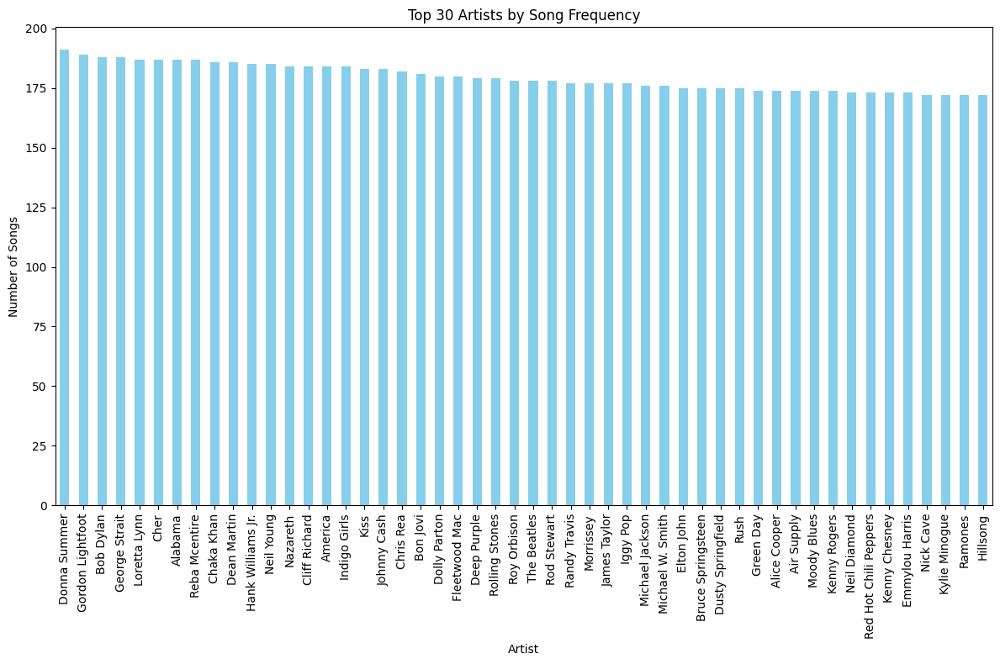

In [45]:
artist_song_freq = spotifyDFCopy['artist'].value_counts().nlargest(50)
plt.figure(figsize=(12, 8))
artist_song_freq.plot(kind='bar', color='skyblue')
plt.title('Top 30 Artists by Song Frequency')
plt.xlabel('Artist')
plt.ylabel('Number of Songs')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

## Words in lyrics per song

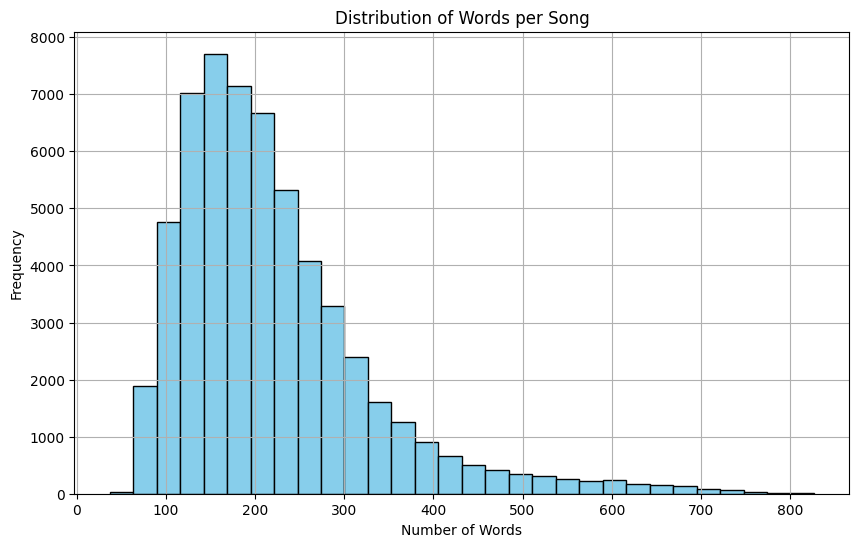

In [46]:
word_counts = []
for lyrics in spotifyDFCopy['text']:
    word_count = len(lyrics.split())
    word_counts.append(word_count)

plt.figure(figsize=(10, 6))
plt.hist(word_counts, bins=30, color='skyblue', edgecolor='black')
plt.title('Distribution of Words per Song')
plt.xlabel('Number of Words')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

## Repetition of words in a song

In [47]:
from collections import Counter

def calculate_repetition_scores(songs_lemmatized):
    repetition_scores = []
    for song_lyrics in songs_lemmatized:
        stem_counts = Counter(song_lyrics)
        unique_stems = len(stem_counts)
        total_stems = sum(stem_counts.values())
        repetition_score = unique_stems / total_stems if total_stems > 0 else 0
        repetition_scores.append(repetition_score)
    return repetition_scores


In [48]:
repetition_scores = calculate_repetition_scores(final_DF_after_cleaning)
print("Repetition Scores:", repetition_scores)


Repetition Scores: [0.6428571428571429, 0.36607142857142855, 0.3945578231292517, 0.48936170212765956, 0.48936170212765956, 0.8541666666666666, 0.569620253164557, 0.4609375, 0.5982905982905983, 0.3548387096774194, 0.3829787234042553, 0.48936170212765956, 0.7017543859649122, 0.40336134453781514, 0.43434343434343436, 0.40625, 0.5555555555555556, 0.3409090909090909, 0.660377358490566, 0.4127659574468085, 0.851063829787234, 0.5051546391752577, 0.38686131386861317, 0.38, 0.3333333333333333, 0.8181818181818182, 0.6951219512195121, 0.48214285714285715, 0.4215686274509804, 0.4482758620689655, 0.5634920634920635, 0.3557692307692308, 0.3770491803278688, 0.37209302325581395, 0.45977011494252873, 0.4334763948497854, 0.40384615384615385, 0.37662337662337664, 0.6027397260273972, 0.4358974358974359, 0.6567164179104478, 0.6376811594202898, 0.3172043010752688, 0.4824561403508772, 0.6176470588235294, 0.3150684931506849, 0.8333333333333334, 0.5675675675675675, 0.36496350364963503, 0.3763440860215054, 0.67

KeyboardInterrupt: 

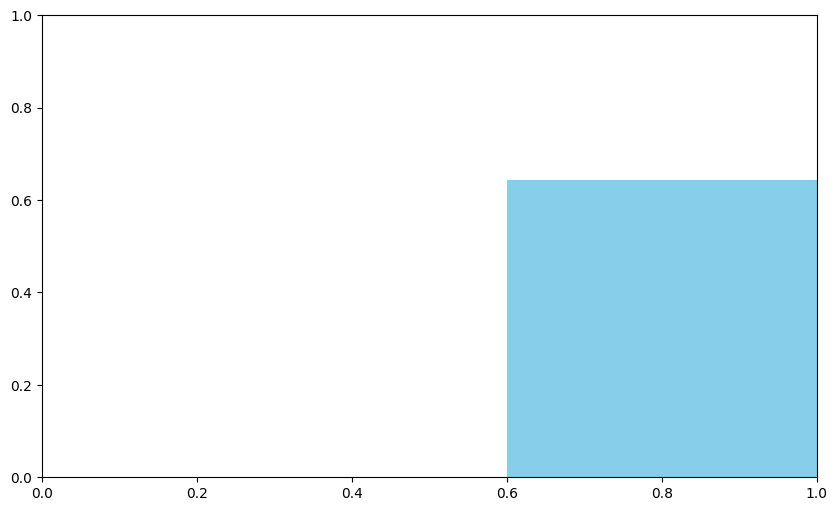

In [60]:
plt.figure(figsize=(10, 6))
plt.bar(range(1, len(repetition_scores) + 1), repetition_scores, color='skyblue')
plt.xlabel('Song Index')
plt.ylabel('Repetition Score')
plt.title('Repetition Scores of Songs')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

## Top words in song lyrics

In [50]:
from wordcloud import WordCloud

lyrics = spotifyDFCopy['text'].str.cat(sep=' ')
words = lyrics.split()
word_freq = Counter(words)
top_words = word_freq.most_common(20)
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)

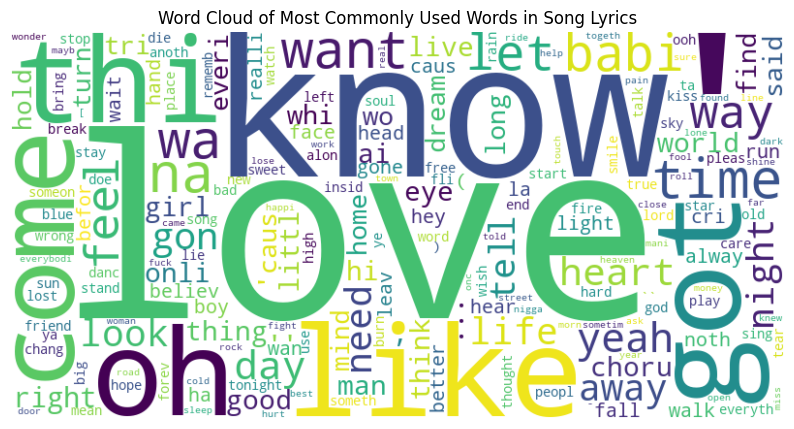

In [119]:
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Most Commonly Used Words in Song Lyrics')
plt.show()

In [52]:
filtered_words = [word.lower() for array in final_DF_after_cleaning for word in array]
word_freq = Counter(filtered_words)
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)

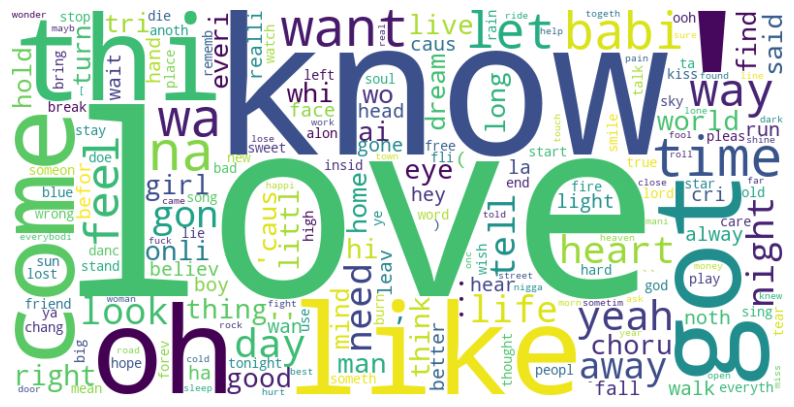

In [53]:
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

## Milestone 2

In [121]:
import tensorflow as tf
from tensorflow.keras.datasets import imdb
from tensorflow.keras.preprocessing import sequence
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Embedding, SimpleRNN
from sklearn.model_selection import train_test_split

# Preparing the Dataset 

After tokenizing, stemming, removing punctuations ,lines and stop words, we saved the pre-cleadned version of each song in a new column called 'text_cleaned'

In [65]:
spotifyDFCopy['text_cleaned']

0        [look, face, wonder, face, mean, someth, speci...
1        [easi, pleas, touch, gentli, like, summer, bre...
2        [know, whi, whi, lousi, rotten, boy, wa, tough...
3        [somebodi, happi, question, learn, come, break...
4        [somebodi, happi, question, learn, come, break...
                               ...                        
57645    [iri, day, come, play, let, angel, fli, let, d...
57646    [power, worker, power, power, worker, need, po...
57647    [need, someth, believ, flashlight, hall, caus,...
57648    [northern, star, frighten, rest, sleep, fight,...
57649    [come, home, bit, late, hate, wait, heart, son...
Name: text_cleaned, Length: 57650, dtype: object

Now we need to clean that new column based on the data analysis that we did before.

Firstly, we need to remove any songs that have a repitition score above 0.7, since it would be useless to have a song made up of 2-3 words.

In [97]:
def filter_songs_by_repetition(df, threshold=0.7):
  df['repetition_score'] = calculate_repetition_scores(df['text_cleaned'])  
  filtered_df = df[df['repetition_score'] <= threshold]

  return filtered_df

In [98]:
spotifyDFCopy.head(10)

,artist,song,link,text,text_cleaned
0,ABBA,Ahe's My Kind Of Girl,/a/abba/ahes+my+kind+of+girl_20598417.html,"Look at her face, it's a wonderful face \r\nA...","[look, face, wonder, face, mean, someth, speci..."
1,ABBA,"Andante, Andante",/a/abba/andante+andante_20002708.html,"Take it easy with me, please \r\nTouch me gen...","[easi, pleas, touch, gentli, like, summer, bre..."
2,ABBA,As Good As New,/a/abba/as+good+as+new_20003033.html,I'll never know why I had to go \r\nWhy I had...,"[know, whi, whi, lousi, rotten, boy, wa, tough..."
3,ABBA,Bang,/a/abba/bang_20598415.html,Making somebody happy is a question of give an...,"[somebodi, happi, question, learn, come, break..."
4,ABBA,Bang-A-Boomerang,/a/abba/bang+a+boomerang_20002668.html,Making somebody happy is a question of give an...,"[somebodi, happi, question, learn, come, break..."
5,ABBA,Burning My Bridges,/a/abba/burning+my+bridges_20003011.html,"Well, you hoot and you holler and you make me ...","[hoot, holler, mad, alway, heel, holi, christ,..."
6,ABBA,Cassandra,/a/abba/cassandra_20002811.html,Down in the street they're all singing and sho...,"[street, sing, shout, stay, aliv, citi, dead, ..."
7,ABBA,Chiquitita,/a/abba/chiquitita_20002978.html,"Chiquitita, tell me what's wrong \r\nYou're e...","[chiquitita, tell, wrong, enchain, sorrow, eye..."
8,ABBA,Crazy World,/a/abba/crazy+world_20003013.html,I was out with the morning sun \r\nCouldn't s...,"[wa, morn, sun, sleep, thought, walk, wa, thin..."
9,ABBA,Crying Over You,/a/abba/crying+over+you_20177611.html,I'm waitin' for you baby \r\nI'm sitting all ...,"[waitin, ', babi, sit, alon, feel, cold, chill..."


In [99]:
spotifyDFCopy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57650 entries, 0 to 57649
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   artist        57650 non-null  object
 1   song          57650 non-null  object
 2   link          57650 non-null  object
 3   text          57650 non-null  object
 4   text_cleaned  57650 non-null  object
dtypes: object(5)
memory usage: 2.2+ MB


In [100]:
spotifyDFCopy=filter_songs_by_repetition(spotifyDFCopy)
spotifyDFCopy.head(10)

,artist,song,link,text,text_cleaned,repetition_score
0,ABBA,Ahe's My Kind Of Girl,/a/abba/ahes+my+kind+of+girl_20598417.html,"Look at her face, it's a wonderful face \r\nA...","[look, face, wonder, face, mean, someth, speci...",0.642857
1,ABBA,"Andante, Andante",/a/abba/andante+andante_20002708.html,"Take it easy with me, please \r\nTouch me gen...","[easi, pleas, touch, gentli, like, summer, bre...",0.366071
2,ABBA,As Good As New,/a/abba/as+good+as+new_20003033.html,I'll never know why I had to go \r\nWhy I had...,"[know, whi, whi, lousi, rotten, boy, wa, tough...",0.394558
3,ABBA,Bang,/a/abba/bang_20598415.html,Making somebody happy is a question of give an...,"[somebodi, happi, question, learn, come, break...",0.489362
4,ABBA,Bang-A-Boomerang,/a/abba/bang+a+boomerang_20002668.html,Making somebody happy is a question of give an...,"[somebodi, happi, question, learn, come, break...",0.489362
6,ABBA,Cassandra,/a/abba/cassandra_20002811.html,Down in the street they're all singing and sho...,"[street, sing, shout, stay, aliv, citi, dead, ...",0.569620
7,ABBA,Chiquitita,/a/abba/chiquitita_20002978.html,"Chiquitita, tell me what's wrong \r\nYou're e...","[chiquitita, tell, wrong, enchain, sorrow, eye...",0.460938
8,ABBA,Crazy World,/a/abba/crazy+world_20003013.html,I was out with the morning sun \r\nCouldn't s...,"[wa, morn, sun, sleep, thought, walk, wa, thin...",0.598291
9,ABBA,Crying Over You,/a/abba/crying+over+you_20177611.html,I'm waitin' for you baby \r\nI'm sitting all ...,"[waitin, ', babi, sit, alon, feel, cold, chill...",0.354839
10,ABBA,Dance,/a/abba/dance_10001507.html,"Oh, my love it makes me sad. \r\nWhy did thin...","[oh, love, sad, whi, thing, turn, bad, wa, dre...",0.382979


In [101]:
print(spotifyDFCopy.info())

<class 'pandas.core.frame.DataFrame'>
Index: 44909 entries, 0 to 57649
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   artist            44909 non-null  object 
 1   song              44909 non-null  object 
 2   link              44909 non-null  object 
 3   text              44909 non-null  object 
 4   text_cleaned      44909 non-null  object 
 5   repetition_score  44909 non-null  float64
dtypes: float64(1), object(5)
memory usage: 2.4+ MB
None


In [114]:
def most_frequent_numbers(arr, k):
    counter = Counter(arr)
    most_common = counter.most_common(k)
    return [item[0] for item in most_common]
result = most_frequent_numbers(word_counts, 1)
maxWordsInSong=result[0]
print(maxWordsInSong)

153


In [132]:
test = spotifyDFCopy['text_cleaned']
test


0        [look, face, wonder, face, mean, someth, speci...
1        [easi, pleas, touch, gentli, like, summer, bre...
2        [know, whi, whi, lousi, rotten, boy, wa, tough...
3        [somebodi, happi, question, learn, come, break...
4        [somebodi, happi, question, learn, come, break...
                               ...                        
57645    [iri, day, come, play, let, angel, fli, let, d...
57646    [power, worker, power, power, worker, need, po...
57647    [need, someth, believ, flashlight, hall, caus,...
57648    [northern, star, frighten, rest, sleep, fight,...
57649    [come, home, bit, late, hate, wait, heart, son...
Name: text_cleaned, Length: 44909, dtype: object

The train_test_split function from scikit-learn shuffles the dataset before splitting it into training and testing sets, thus there's no need to shuffle the whole dataset before splitting, or the seperate train/test datasets after splitting.

In [138]:
train_df, test_df = train_test_split(spotifyDFCopy, test_size=0.2, random_state=42)  # Set random state for reproducibility

print("Training Set Shape:", train_df.shape)
print("Testing Set Shape:", test_df.shape)


Training Set Shape: (35927, 6)
Testing Set Shape: (8982, 6)


# Train dataset Preprocessing

Creating an encoder for the training dataset and then vectorizing it using a word count based embeddings

In [ ]:
VOCAB_SIZE = len(vocab)
encoder1 = tf.keras.layers.TextVectorization(
    max_tokens=VOCAB_SIZE)
train_df['text_cleaned'] = train_df['text_cleaned'].apply(lambda x: ' '.join(x))
encoder1.adapt(train_df['text_cleaned'])

In [ ]:
vocab = np.array(encoder1.get_vocabulary())
vocab[:20]

array(['', '[UNK]', 'love', 'know', 'oh', 'like', 'got', 'thi', 'na',
       'come', 'time', 'want', 'babi', 'wa', 'let', 'feel', 'yeah', 'way',
       'gon', 'heart'], dtype='<U67')

In [ ]:
(train_df['text_cleaned'])

9236     babi relax wait thi deserv heavenli bliss wait...
47348    peopl like shake run drive crazi like steal ro...
30490    know way mani peopl right know year fuck y'all...
37437    oh better watch better cri better pout tell wh...
1964     bright like dream burn everyth scene ignit gas...
                               ...                        
14395    jenni mani time tri away kept follow town disp...
57424    away ani desir hurt away anyth stand want crea...
48802    word music brent wilson pictur worth thousand ...
1075     love love whi stop cryin ' dri weep eye know l...
20417    ai reason whi let wait let set straight got ri...
Name: text_cleaned, Length: 35927, dtype: object

In [ ]:
train_vectorized = encoder1((train_df['text_cleaned']))

In [ ]:
train_vectorized

<tf.Tensor: shape=(35927, 658), dtype=int64, numpy=
array([[   12,  1527,    66, ...,     0,     0,     0],
       [   96,     5,   298, ...,     0,     0,     0],
       [    3,    17,   190, ...,     0,     0,     0],
       ...,
       [  109,   223, 22611, ...,     0,     0,     0],
       [    2,     2,    41, ...,     0,     0,     0],
       [   35,   239,    41, ...,     0,     0,     0]], dtype=int64)>

# Test Dataset preprocessing

Creating an encoder for the training dataset and then vectorizing it using a word count based embeddings

In [171]:
VOCAB_SIZE = len(vocab)
encoder2 = tf.keras.layers.TextVectorization(
    max_tokens=VOCAB_SIZE)
test_df['text_cleaned'] = test_df['text_cleaned'].apply(lambda x: ' '.join(x))
encoder2.adapt(test_df['text_cleaned'])

In [172]:
vocab = np.array(encoder2.get_vocabulary())
vocab[:20]

array(['', '[UNK]', 'love', 'know', 'got', 'like', 'oh', 'thi', 'na',
       'come', 'time', 'want', 'babi', 'wa', 'let', 'yeah', 'feel', 'way',
       'day', 'gon'], dtype='<U45')

In [173]:
(test_df['text_cleaned'])

34176    someon walk turn look someon watch footstep tu...
26496    love life know need like touch star came life ...
22024    born night run like leopard freak sight mind c...
52835    hallelujah king dead said '' love wa knife `` ...
45553    cherri bleed moon steep mild nad blood taht st...
                               ...                        
13897    know told seek sanctuari guess thing devil rou...
28508    dear john wrong whi anyth want whi whi tri tel...
37345    live small town . deep la mile north laker pla...
40216    rememb rio like dj town tri tell hold tight wa...
20186    1-2-3 ... life afford fear pain frustrat need ...
Name: text_cleaned, Length: 8982, dtype: object

In [174]:
test_vectorized = encoder2((test_df['text_cleaned']))

In [175]:
test_vectorized

<tf.Tensor: shape=(8982, 474), dtype=int64, numpy=
array([[ 115,   65,   54, ...,    0,    0,    0],
       [   2,   23,    3, ...,    0,    0,    0],
       [ 272,   25,   60, ...,    0,    0,    0],
       ...,
       [  37,  532,  192, ...,    0,    0,    0],
       [ 135, 4046,    5, ...,    0,    0,    0],
       [4177,   23, 2280, ...,    0,    0,    0]], dtype=int64)>

# Padding

In [177]:
input_train = sequence.pad_sequences(train_vectorized, maxlen=maxWordsInSong)
input_test = sequence.pad_sequences(test_vectorized, maxlen=maxWordsInSong)
print('input_train shape:', input_train.shape)
print('input_test shape:', input_test.shape)

input_train shape: (35927, 153)
input_test shape: (8982, 153)


# Create the model

In [178]:
model = tf.keras.Sequential([
    encoder,
    tf.keras.layers.Embedding(
        input_dim=len(encoder.get_vocabulary()),
        output_dim=64,
        # Use masking to handle the variable sequence lengths
        mask_zero=True),
    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(64)),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid')
])

In [ ]:
#LAB 4 and 5